In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
# Lets import yolo 
from ultralytics import YOLO



image 1/1 d:\yolo\align_image_using_template\images\citizenship_image\_110.jpg: 640x480 1 citizenship, 183.3ms
Speed: 5.7ms preprocess, 183.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)


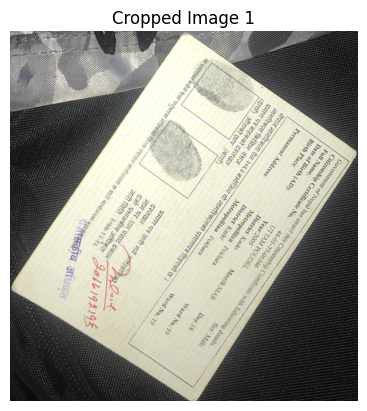

In [2]:
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt

# Step 1: Load the pre-trained YOLO model
model = YOLO("./my_model/citizenship_detection/my_model.pt")

# Step 2: Perform detection on the image
image_path = "./images/citizenship_image/_110.jpg" 
image = cv2.imread(image_path)  # Read the original image
results = model(image_path)  # Perform object detection

# Step 3: Extract bounding boxes with high confidence
cropped_images = []
confidence_threshold = 0.5  # Set the confidence threshold
for result in results:
    for box in result.boxes:  # Iterate over detected boxes
        if box.conf > confidence_threshold:  # Check confidence
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Extract box coordinates
            cropped_images.append(image[y1:y2, x1:x2])  # Crop the ROI

# Step 4: Display cropped areas using matplotlib
for i, cropped in enumerate(cropped_images):
    plt.figure()
    plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for plt
    plt.axis("off")
    plt.title(f"Cropped Image {i+1}")
    plt.show()

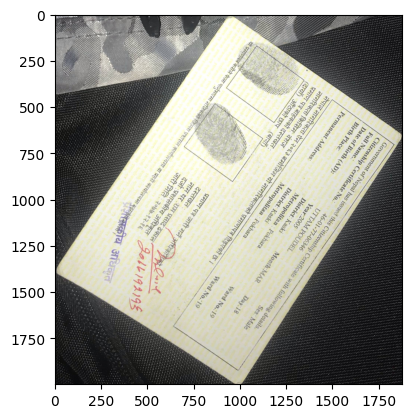

In [3]:
result_from_yolo = cropped_images[0]
im1 = cv2.cvtColor(result_from_yolo, cv2.COLOR_BGR2RGB)
plt.imshow(im1)

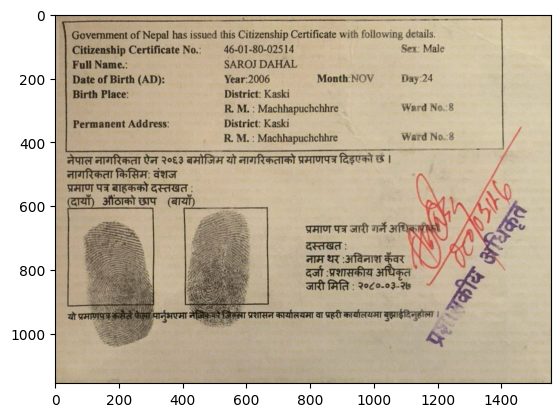

In [4]:
#load the another image
im2 = './images/template_images/temp_1.jpg'
im2 = cv2.imread(im2, cv2.IMREAD_COLOR)
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)
plt.imshow(im2)

<Figure size 2000x2000 with 0 Axes>

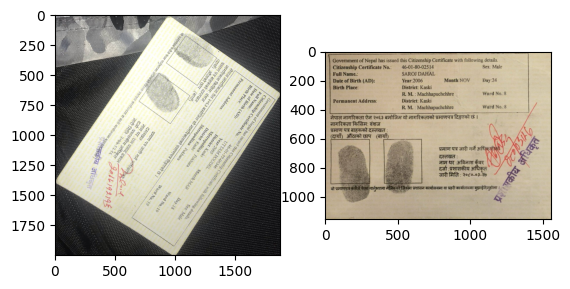

In [5]:
#lets display both 
plt.figure(figsize=(20,20))
fig, ax = plt.subplots(1,2)
ax[0].imshow(im1)
ax[1].imshow(im2)

<Figure size 2000x2000 with 0 Axes>

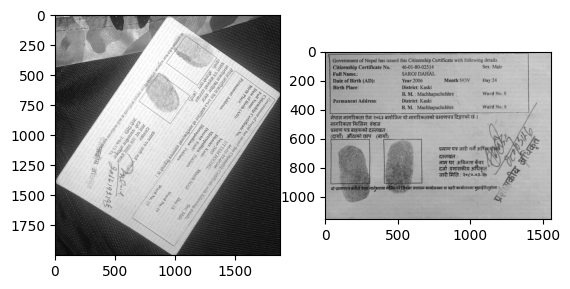

In [6]:
#convert image to grayscale 
im1_gray = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY)
im2_gray = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY)

#lets display both
plt.figure(figsize=(20,20))
fig, ax = plt.subplots(1,2)
ax[0].imshow(im1_gray, cmap='gray')
ax[1].imshow(im2_gray, cmap='gray')

In [7]:
#detect orb feartures 
MAX_NUMBER_OF_FEATURES = 4000
orb = cv2.ORB_create(MAX_NUMBER_OF_FEATURES)
keypoints1, descriptors1 = orb.detectAndCompute(im1_gray, None)
keypoints2, descriptors2 = orb.detectAndCompute(im2_gray, None)


#display
im1_display = cv2.drawKeypoints(im1, keypoints1, outImage=np.array([]), color=(255,0,0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im2_display = cv2.drawKeypoints(im2, keypoints2,  outImage=np.array([]), color=(255,0,0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

<Figure size 2000x2000 with 0 Axes>

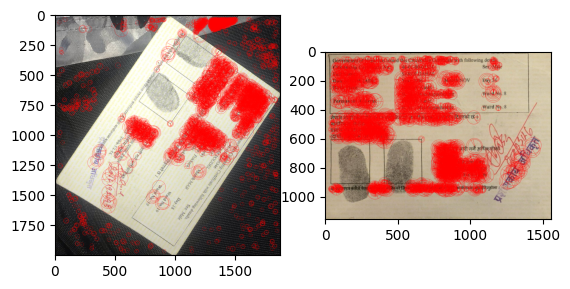

In [8]:
# display now 
plt.figure(figsize=(20,20))
fig, ax = plt.subplots(1,2)
ax[0].imshow(im1_display)
ax[1].imshow(im2_display)

In [9]:
# match features
matcher = cv2.DescriptorMatcher_create(cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING)
matches = matcher.match(descriptors1, descriptors2, None)

# sort matches by score 
matches = sorted(matches, key=lambda x: x.distance)
# Remove not so good matches
numGoodMatches = int(len(matches) * 0.1)
matches = matches[:numGoodMatches]

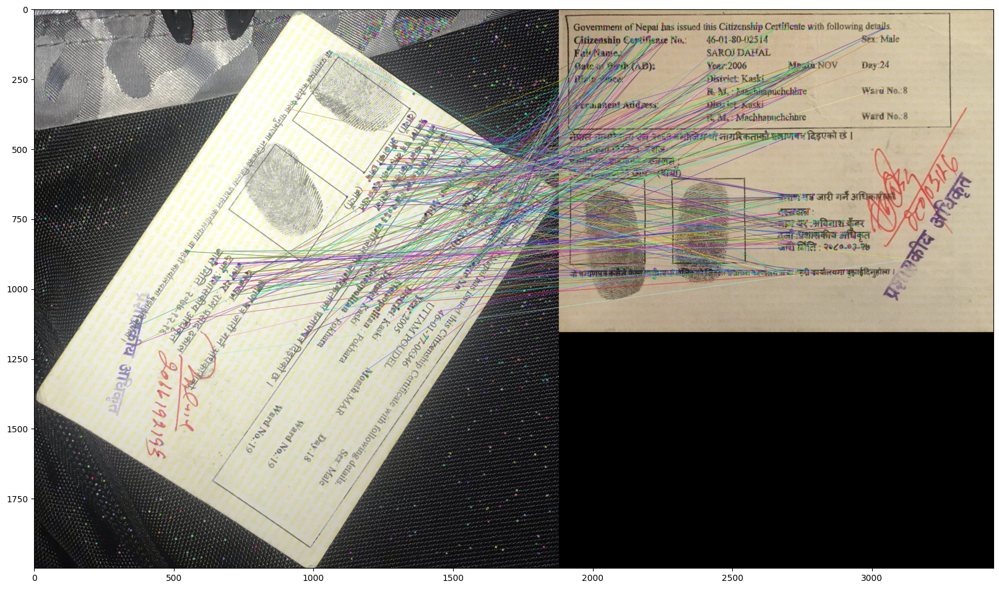

In [10]:
#draw top matches 
im_matches = cv2.drawMatches(im1, keypoints1, im2, keypoints2, matches, None)
plt.figure(figsize=(20,20))
plt.imshow(im_matches)

In [11]:
#Extract location of good matches
points1 = np.zeros((len(matches), 2), dtype=np.float32)
points2 = np.zeros((len(matches), 2), dtype=np.float32)

for i, match in enumerate(matches):
    points1[i, :] = keypoints1[match.queryIdx].pt
    points2[i, :] = keypoints2[match.trainIdx].pt


#find homography matrix
homo, mask = cv2.findHomography(points1, points2, cv2.RANSAC)

<Figure size 3000x3000 with 0 Axes>

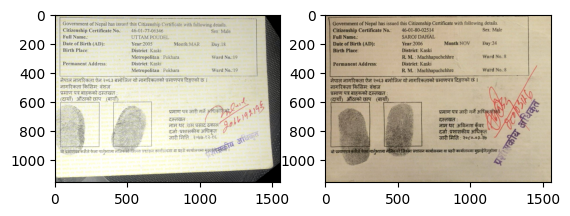

In [12]:
# use homography to warp image
im1_reg = cv2.warpPerspective(im1, homo, (im2.shape[1], im2.shape[0]))
plt.figure(figsize=(30,30))
fig, ax = plt.subplots(1,2)
ax[0].imshow(im1_reg)
ax[1].imshow(im2)

In [13]:
# Lets generate a function that perform all the above codes

In [14]:
def detect_citizenship(image_path):
    image = cv2.imread(image_path)  # Read the original image
    results = model(image_path)  # Perform object detection
    
    # Step 3: Extract bounding boxes with high confidence
    cropped_images = []
    boxes_with_conf = []
    confidence_threshold = 0.5  # Set the confidence threshold
    for result in results:
        for box in result.boxes:  # Iterate over detected boxes
            if box.conf > confidence_threshold:  # Check confidence
                boxes_with_conf.append((box, float(box.conf[0])))
    
    # Sort boxes by confidence in descending order
    boxes_with_conf.sort(key=lambda x: x[1], reverse=True)
    
    # Crop images in order of confidence
    for box, _ in boxes_with_conf:
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Extract box coordinates
        cropped_images.append(image[y1:y2, x1:x2])  # Crop the ROI
    
    return cropped_images[0] if cropped_images else None

In [15]:
def align_image(image, target, MAX_NUMBER_OF_FEATURES = 4000):
    # Convert the images to grayscale
    image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    target_gray = cv2.cvtColor(target, cv2.COLOR_BGR2GRAY)

    #detect orb feartures 
    orb = cv2.ORB_create(MAX_NUMBER_OF_FEATURES)
    keypoints1, descriptors1 = orb.detectAndCompute(image_gray, None)
    keypoints2, descriptors2 = orb.detectAndCompute(target_gray, None)

    # match features
    matcher = cv2.DescriptorMatcher_create(cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING)
    matches = matcher.match(descriptors1, descriptors2, None)

    # sort matches by score 
    matches = sorted(matches, key=lambda x: x.distance)
    # Remove not so good matches
    numGoodMatches = int(len(matches) * 0.1)
    matches = matches[:numGoodMatches]

    
    #Extract location of good matches
    points1 = np.zeros((len(matches), 2), dtype=np.float32)
    points2 = np.zeros((len(matches), 2), dtype=np.float32)

    for i, match in enumerate(matches):
        points1[i, :] = keypoints1[match.queryIdx].pt
        points2[i, :] = keypoints2[match.trainIdx].pt


    #find homography matrix
    homo, mask = cv2.findHomography(points1, points2, cv2.RANSAC)

    im1_reg = cv2.warpPerspective(image_gray, homo, (target_gray.shape[1], target_gray.shape[0]))

    return im1_reg


    
    

In [16]:
result_from_yolo = detect_citizenship('./images/citizenship_image/_110.jpg')
detect_citizen = im1 = cv2.cvtColor(result_from_yolo, cv2.COLOR_BGR2RGB)




image 1/1 d:\yolo\align_image_using_template\images\citizenship_image\_110.jpg: 640x480 1 citizenship, 169.8ms
Speed: 4.0ms preprocess, 169.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)


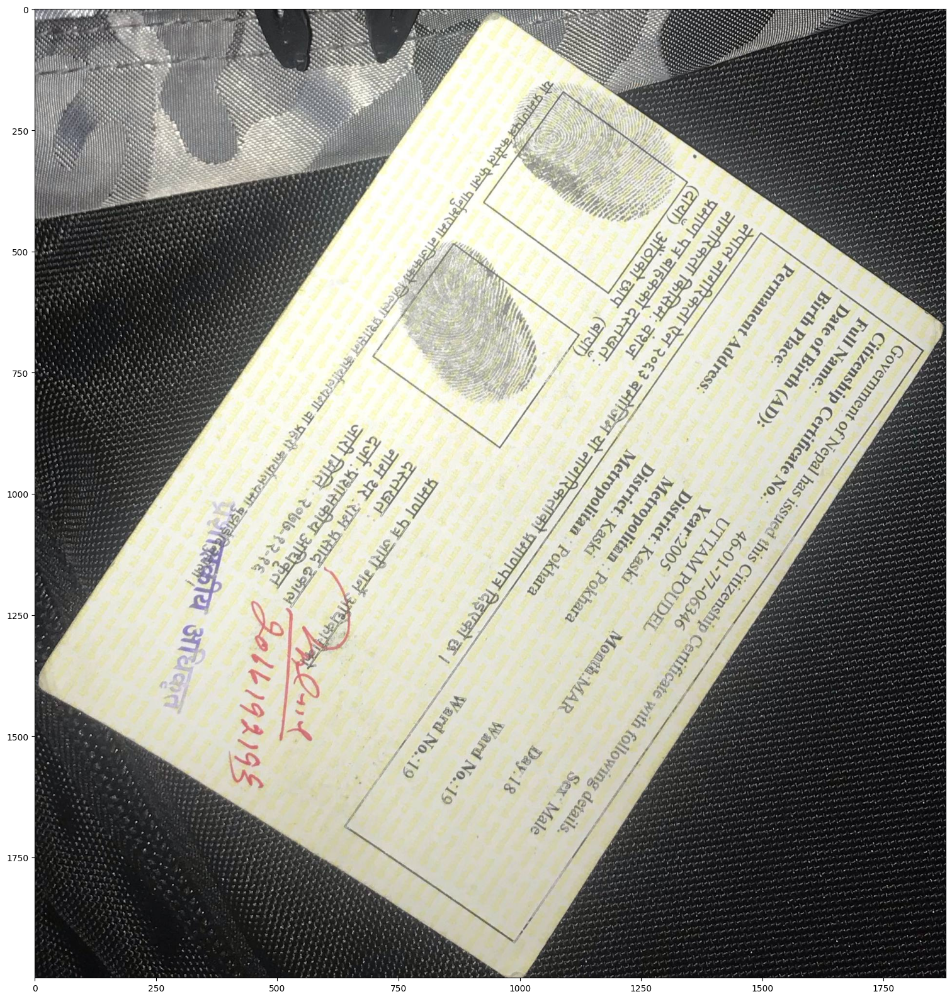

In [17]:
plt.figure(figsize=(20,20))
plt.imshow(detect_citizen)

In [18]:
#load the another image
im2 = './images/template_images/temp_2.jpg'
im2 = cv2.imread(im2, cv2.IMREAD_COLOR)
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)
# plt.imshow(im2)
aligned_image = align_image(detect_citizen, im2)

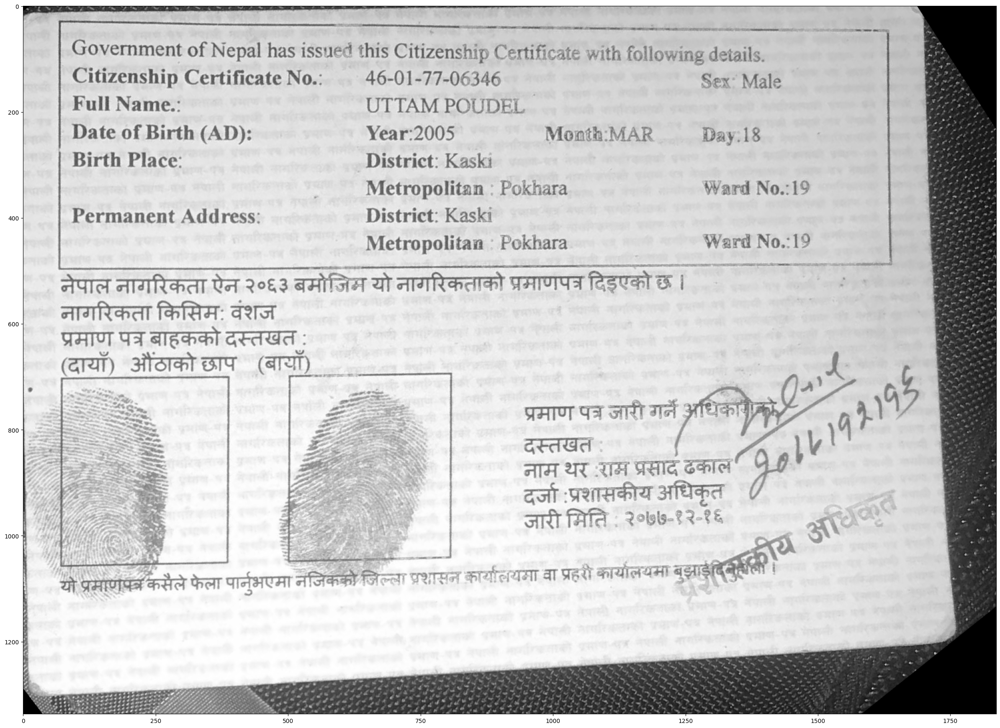

In [19]:
aligned_image = cv2.cvtColor(aligned_image, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(30,30))
plt.imshow(aligned_image)

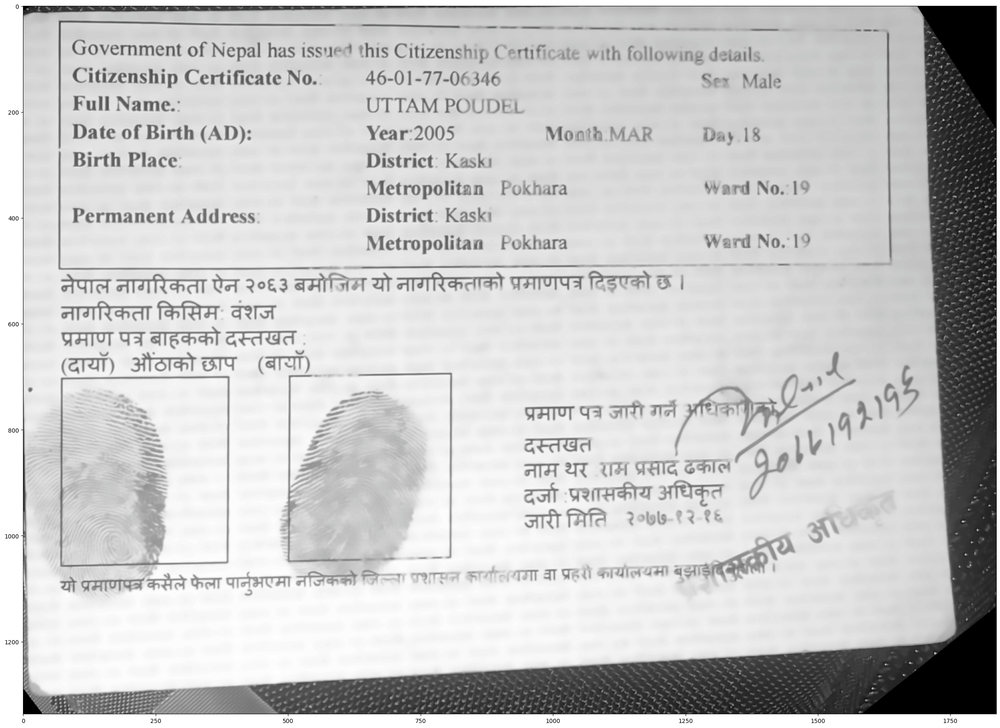

In [20]:
denoised = cv2.fastNlMeansDenoisingColored(aligned_image, None, h=10, hColor=10, templateWindowSize=7, searchWindowSize=21)
plt.figure(figsize=(30,30))
plt.imshow(denoised)

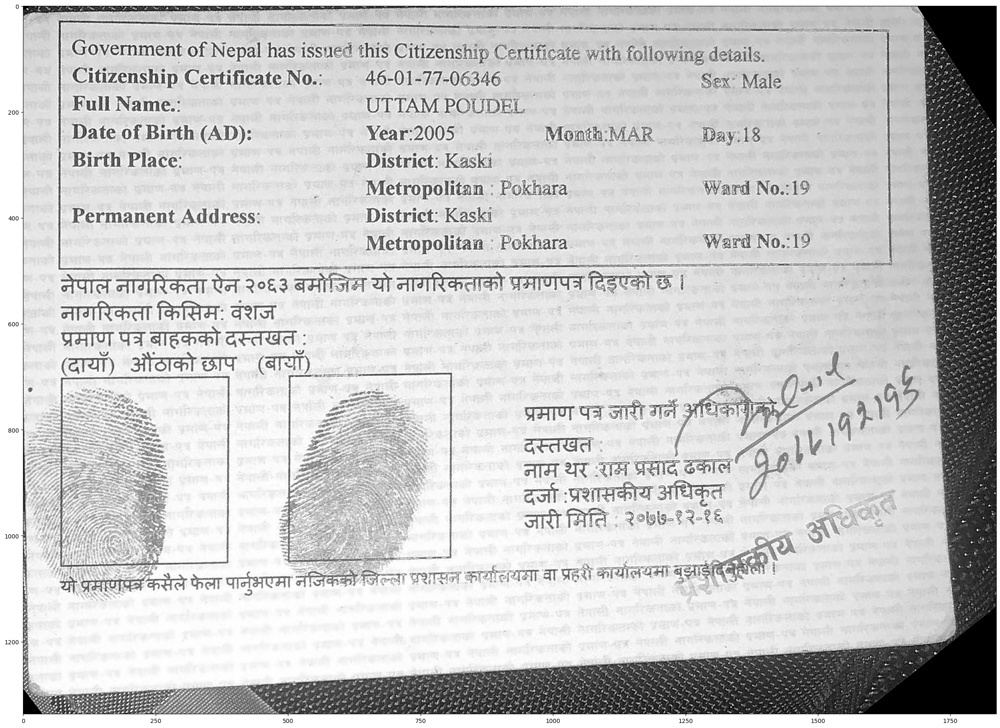

In [21]:
import numpy as np

kernel = np.array([[0, -1, 0],
                   [-1, 5,-1],
                   [0, -1, 0]])
sharpened = cv2.filter2D(src=aligned_image, ddepth=-1, kernel=kernel)

plt.figure(figsize=(30,30))
plt.imshow(sharpened)

In [22]:
# Sharpend is the final aligned citizenship 

In [23]:
# Now again load the model and get the result
field_detection_model = YOLO("./my_model/field_detection_model/my_model.pt")

In [24]:
# Add this line after model definition
class_names = field_detection_model.names  # dict like {0: 'name', 1: 'age', ...}


In [25]:
# results = field_detection_model(sharpened)
# # Step 3: Extract bounding boxes with high confidence
# cropped_images = []
# boxes_with_conf = []
# confidence_threshold = 0.5  # Set the confidence threshold
# for result in results:
#     for box in result.boxes:  # Iterate over detected boxes
#         if box.conf > confidence_threshold:  # Check confidence
#             boxes_with_conf.append((box, float(box.conf[0])))
# # Sort boxes by confidence in descending order  
# boxes_with_conf.sort(key=lambda x: x[1], reverse=True)
# # Crop images in order of confidence
# for box, _ in boxes_with_conf:
#     x1, y1, x2, y2 = map(int, box.xyxy[0])  # Extract box coordinates
#     cropped_images.append(sharpened[y1:y2, x1:x2])  # Crop the ROI

# # Display cropped areas using matplotlib
# for box, _ in boxes_with_conf:
#     x1, y1, x2, y2 = map(int, box.xyxy[0])
#     cropped = sharpened[y1:y2, x1:x2]
#     class_id = int(box.cls[0])
#     label = class_names[class_id]  # Get class name from ID

#     plt.figure()
#     plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
#     plt.axis("off")
#     plt.title(label)
#     plt.show()


In [26]:
results = field_detection_model(sharpened)

# Step 1: Extract bounding boxes with high confidence
boxes_with_conf = []
confidence_threshold = 0.5
for result in results:
    for box in result.boxes:
        if box.conf > confidence_threshold:
            boxes_with_conf.append((box, float(box.conf[0])))

# Step 2: Sort boxes by confidence
boxes_with_conf.sort(key=lambda x: x[1], reverse=True)

# Step 3: Store cropped images in a dictionary by label
cropped_dict = {}

for box, _ in boxes_with_conf:
    x1, y1, x2, y2 = map(int, box.xyxy[0])
    cropped = sharpened[y1:y2, x1:x2]
    class_id = int(box.cls[0])
    label = class_names[class_id]

    if label not in cropped_dict:
        cropped_dict[label] = []

    cropped_dict[label].append(cropped)



0: 480x640 1 bamsha, 1 birth_place_district, 1 bp_metropolitan, 1 bp_ward, 1 citizenship_no, 1 dob_day, 1 dob_month, 1 dob_year, 1 issued_date, 1 name, 1 pa_district, 1 pa_metropolitan, 1 pa_ward, 1 sex, 166.7ms
Speed: 4.1ms preprocess, 166.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


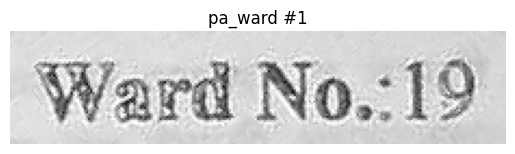

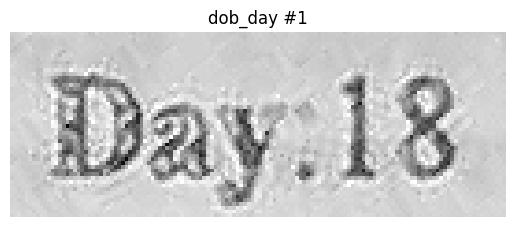

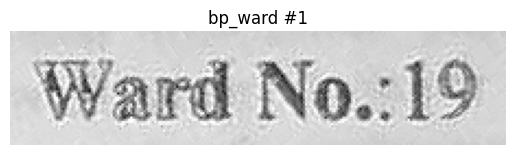

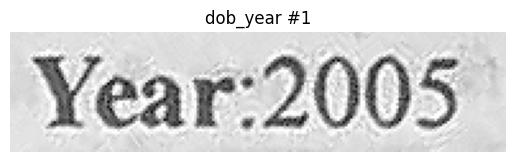

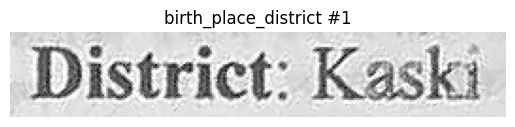

...

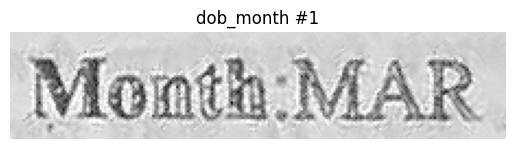

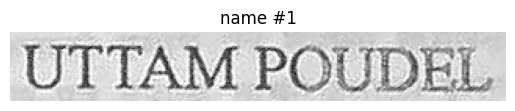

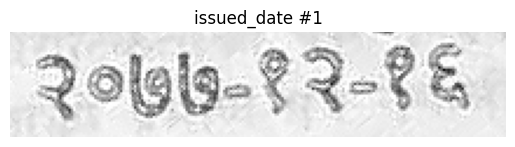

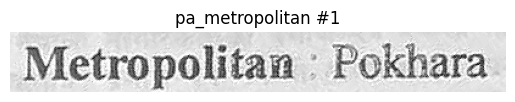

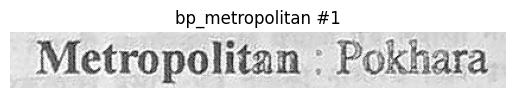

In [27]:
for label, images in cropped_dict.items():
    for i, img in enumerate(images):
        plt.figure()
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.title(f"{label} #{i+1}")
        plt.show()


In [28]:
# Let's store the cropped images in a dictionary for where key is the label name 
cropped_dict = {}
for box, _ in boxes_with_conf:
    x1, y1, x2, y2 = map(int, box.xyxy[0])
    cropped = sharpened[y1:y2, x1:x2]
    class_id = int(box.cls[0])
    label = class_names[class_id]  # Get class name from ID
    if label not in cropped_dict:
        cropped_dict[label] = []
    cropped_dict[label].append(cropped)

In [29]:
cropped_dict = {k: v[0] for k, v in cropped_dict.items()}  # Keep only the first cropped image for each label

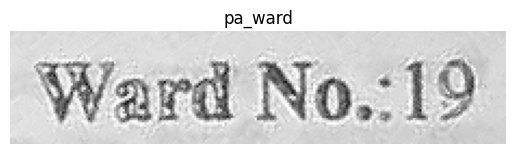

In [30]:
# Display only the first item from the dictionary
for label, cropped in list(cropped_dict.items())[:1]:
    plt.figure()
    plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title(label)
    plt.show()

In [31]:
cropped_dict.keys()  # Display the keys of the dictionary

dict_keys(['pa_ward', 'dob_day', 'bp_ward', 'dob_year', 'birth_place_district', 'sex', 'bamsha', 'citizenship_no', 'pa_district', 'dob_month', 'name', 'issued_date', 'pa_metropolitan', 'bp_metropolitan'])

In [32]:
import cv2
import pytesseract

pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'  # Adjust path if needed


def extract_text_from_image(image, lang='eng'):
    # Convert the image to RGB (OpenCV loads images in BGR format)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    resized = cv2.resize(gray, None, fx=2, fy=2, interpolation=cv2.INTER_LINEAR)
    # Use pytesseract to extract text
    text = pytesseract.image_to_string(resized, lang=lang)  # psm 6 assumes a single uniform block of text
    return text

In [33]:
name = extract_text_from_image(cropped_dict['dob_year'])
print(name)

Year:2005



In [34]:
# # Extract text from the cropped 'name' image
# name_image = cropped_dict.get('name')

# if name_image is not None:
#     name_text = extract_text_from_image(name_image)
#     print("Extracted Name:", name_text)
# else:
#     print("No image found for key 'name'")


In [35]:
# plt.figure(figsize=(10, 10))
# plt.imshow(cv2.cvtColor(name_image, cv2.COLOR_BGR2RGB))

In [36]:
# Now let's perform OCR on the other remaining fields 
fields = ['bamsha', 'birth_place_district', 'bp_metropolitan', 'bp_ward', 'citizenship_no', 'dob_day', 'dob_month', 'dob_year', 'issued_date', 'name', 'pa_district', 'pa_metropolitan', 'pa_ward', 'sex']

In [37]:
def extract_text_from_fields(cropped_dict, fields):
    extracted_text = {}
    for field in fields:
        if field in cropped_dict:
            image = cropped_dict.get(field)

            # Use nepali OCR for bamsha and issued_date, otherwise english
            if field in ['bamsha', 'issued_date']:
                lang = 'nep'
            else:
                lang = 'eng'

            text = extract_text_from_image(image, lang)
            extracted_text[field] = text.strip()
        else:
            extracted_text[field] = None  # Field not found
    return extracted_text


In [ ]:
print(extract_text_from_fields(cropped_dict, fields))

{'bamsha': 'वंशज', 'birth_place_district': 'District: Kaski', 'bp_metropolitan': 'Metropolitan : Pokhara', 'bp_ward': 'Ward No.:19', 'citizenship_no': '46-01-77-06346', 'dob_day': 'Day:18', 'dob_month': 'Month: MAR', 'dob_year': 'Year:2005', 'issued_date': '२०७७-१२-१६', 'name': 'UTTAM POUDEL', 'pa_district': 'District: Kaski', 'pa_metropolitan': 'Metropolitaa | Pokhara', 'pa_ward': 'Ward No.:19', 'sex': 'Sex: Male'}


In [39]:
import cv2

def get_cropped_field_dict(sharpened, field_detection_model, class_names, confidence_threshold=0.5):
    """
    Detects fields in the image using the model and returns a dictionary
    where keys are field labels and values are lists of cropped images.

    Args:
        sharpened (np.ndarray): Preprocessed input image (BGR format).
        field_detection_model: Object detection model (e.g., YOLO).
        class_names (list or dict): Mapping from class ID to class label.
        confidence_threshold (float): Minimum confidence to consider a detection.

    Returns:
        dict: {label: [cropped_images]}
    """
    results = field_detection_model(sharpened)
    boxes_with_conf = []

    # Extract high-confidence boxes
    for result in results:
        for box in result.boxes:
            if box.conf > confidence_threshold:
                boxes_with_conf.append((box, float(box.conf[0])))

    # Sort boxes by confidence descending
    boxes_with_conf.sort(key=lambda x: x[1], reverse=True)

    # Store cropped images in a dict
    cropped_dict = {}
    for box, _ in boxes_with_conf:
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        cropped = sharpened[y1:y2, x1:x2]
        class_id = int(box.cls[0])
        label = class_names[class_id]

        if label not in cropped_dict:
            cropped_dict[label] = []
        cropped_dict[label].append(cropped)

    return cropped_dict


In [40]:
cropped_dict = get_cropped_field_dict(
    sharpened=sharpened,
    field_detection_model=field_detection_model,
    class_names=class_names,
    confidence_threshold=0.5
)



0: 480x640 1 bamsha, 1 birth_place_district, 1 bp_metropolitan, 1 bp_ward, 1 citizenship_no, 1 dob_day, 1 dob_month, 1 dob_year, 1 issued_date, 1 name, 1 pa_district, 1 pa_metropolitan, 1 pa_ward, 1 sex, 162.6ms
Speed: 6.3ms preprocess, 162.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


In [41]:
cropped_dict = {k: v[0] for k, v in cropped_dict.items()}  # Keep only the first cropped image for each label

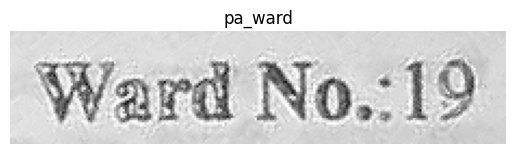

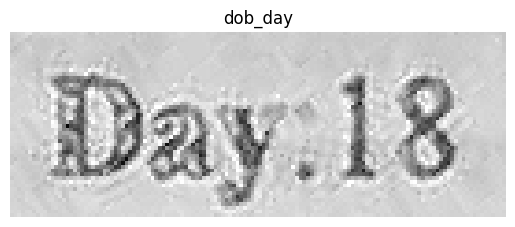

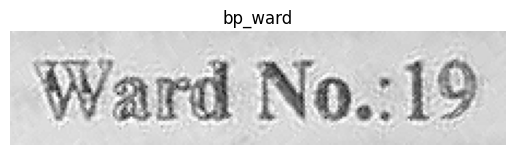

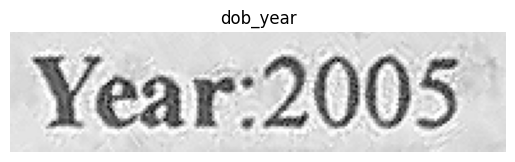

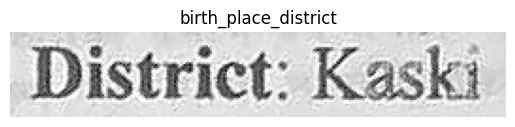

...

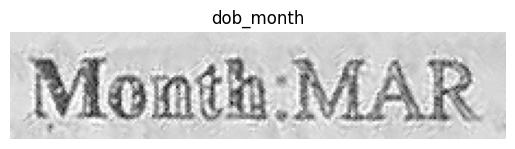

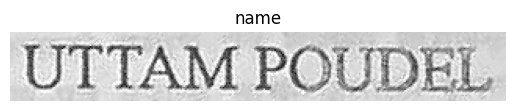

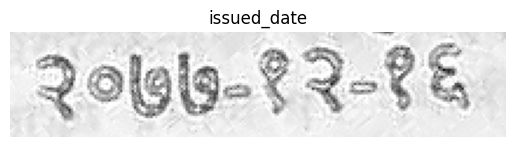

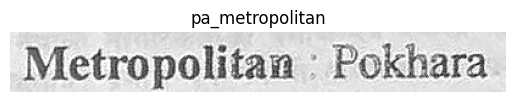

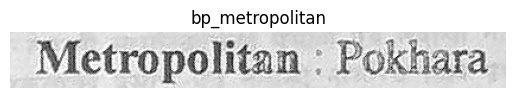

In [43]:
# Display the cropped image stored in the dictionary
for label, cropped in cropped_dict.items():
    plt.figure()
    plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title(label)
    plt.show()